In [15]:
# These are the imports, that are necessary for the project
import glob
import zipfile
import os

import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf

from pathlib import Path
from PIL import Image
from sklearn.metrics import f1_score
from tensorflow.keras import regularizers, initializers, Sequential
from tensorflow.keras.layers import Conv2D, Dropout, MaxPooling2D, Flatten, Dense
from tensorflow.keras.optimizers import SGD
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing.image import ImageDataGenerator, DirectoryIterator
from typing import Tuple

In [16]:
# Paths of data files
train_data_path = 'Test_train_data_amount/Train_60%/'  # 'Train'
test_data_path = 'Test'
validation_data_path = 'Validation'

In [17]:
# Compute sizes of train data (male and female)
train_data_path_male = Path(train_data_path) / "Male"
train_data_path_female = Path(train_data_path) / "Female"

size_of_male_data = len([file_or_dir for file_or_dir in os.listdir(train_data_path_male)
                         if os.path.isfile(train_data_path_male / file_or_dir) and file_or_dir.endswith(".jpg")])
size_of_female_data = len([file_or_dir for file_or_dir in os.listdir(train_data_path_female)
                           if os.path.isfile(train_data_path_female / file_or_dir) and file_or_dir.endswith(".jpg")])

size_of_female_data, size_of_male_data

(4557, 4557)

In [19]:
# Hyperparamter
batch_size = 24
learning_rate = 0.0001
kernel_s = (3, 3)
epochs, steps_per_epoch = 30, 100
early_stopping = EarlyStopping(monitor='val_loss', patience=10)  # Early stopping if model can't get better in training
class_weight = {0: 1.0, 1: size_of_male_data / size_of_male_data}
# class_weight = {0: 1.0, 1: 1.0}

# Additional variables
num_images = 16
class_weight

{0: 1.0, 1: 1.0}

In [20]:
def read_train_validate_test_data_from_file(training_data_path: Path, validation_data_path: Path, testing_data_path: Path,
                                            batch: int=batch_size) -> Tuple[DirectoryIterator, DirectoryIterator, DirectoryIterator]:
    # Read train data from file and augment data
    train_datagen = ImageDataGenerator(
        rotation_range=90,
        width_shift_range=0.2,
        height_shift_range=0.2,
        brightness_range=(0.2, 0.8),  # low value = darker
        shear_range=0.3,
        zoom_range=0.3,
        channel_shift_range=0.5,  # Shifts channel (=rgb values) = seems to be similiar to brightness
        horizontal_flip=True,  # Horizontal flipping fits, vertical is not necessary
        rescale=1./255
    )

    train_gen=train_datagen.flow_from_directory(
        training_data_path,
        target_size=(250,250),
        batch_size=batch,
        class_mode='binary',
        shuffle=True
    )

    # Read validation data from file and augment data
    valid_datagen = ImageDataGenerator(rescale=1./255)

    valid_gen=valid_datagen.flow_from_directory(
        validation_data_path,
        target_size=(250,250),
        batch_size=batch,
        class_mode='binary',
        shuffle=True
    )

    # Read test data from file and augment data
    test_datagen = ImageDataGenerator(rescale=1./255)

    test_gen=test_datagen.flow_from_directory(
        testing_data_path,
        target_size=(250,250),
        batch_size=batch,
        class_mode='binary',
        shuffle=True
    )
    
    return train_gen, valid_gen, test_gen


def generate_model(filter_size: Tuple[int, int]=kernel_s) -> Sequential:
    return Sequential([
        Conv2D(32, filter_size, activation='relu', input_shape=(250,250,3), kernel_regularizer=regularizers.l2(0.001), padding="VALID"),
        MaxPooling2D((2,2)),

        Conv2D(64, filter_size, activation='relu'),
        MaxPooling2D((2,2)),

        Conv2D(64, filter_size, activation='relu'),
        MaxPooling2D((2,2)),

        Conv2D(128, filter_size, activation='relu'),
        MaxPooling2D((2,2)),

        Conv2D(128, filter_size, activation='relu'),
        MaxPooling2D((2,2)),

        # Last layer decise -> preparation for this = some layers before
        Flatten(),
        Dense(256, activation='relu'),
        # Dropout(0.5),
        Dense(1, activation='sigmoid')
    ])

In [24]:
# Read train, validation and test data
train_gen, valid_gen, test_gen = read_train_validate_test_data_from_file(train_data_path, validation_data_path,
                                                                               test_data_path, batch_size)

Found 9114 images belonging to 2 classes.
Found 1000 images belonging to 2 classes.
Found 1001 images belonging to 2 classes.


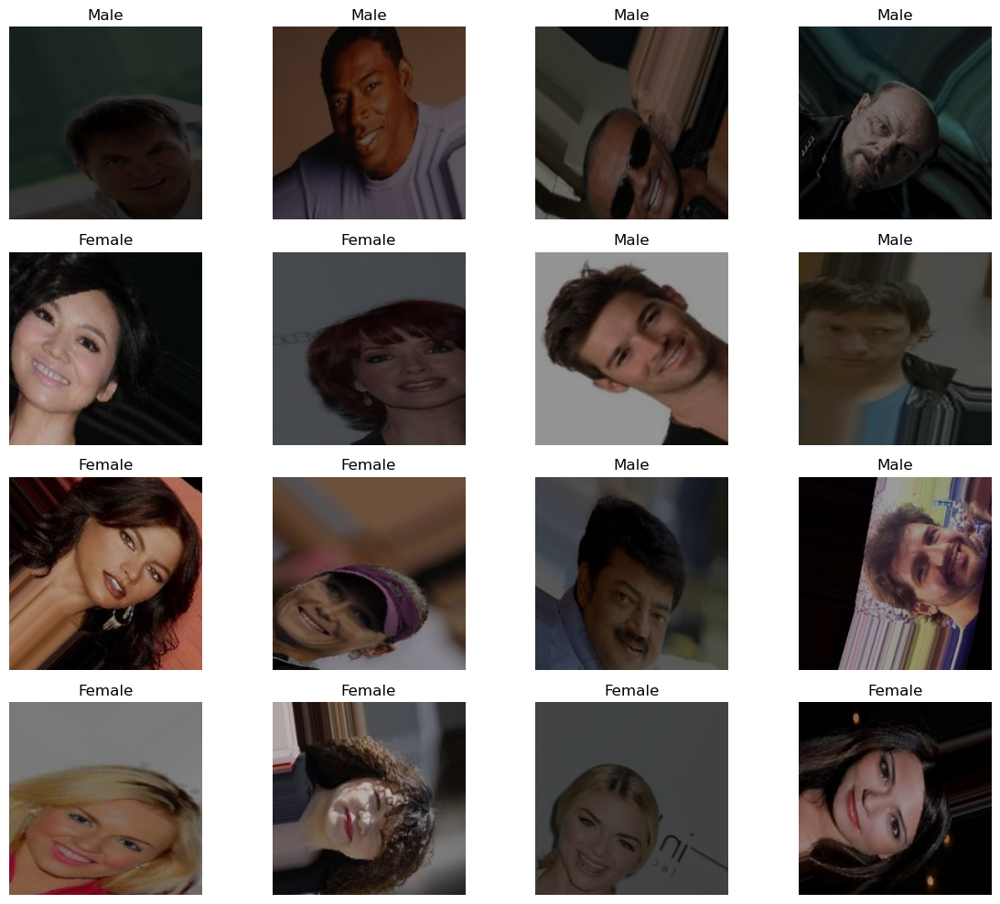

In [22]:
# Show little part of train data
x_batch, y_batch = next(train_gen)

fig, axes = plt.subplots(4, 4, figsize=(12, 10))

for i in range(num_images):
    ax = axes[i // 4, i % 4]
    ax.imshow(x_batch[i])
    label = "Female" if y_batch[i] == 0 else "Male"
    ax.set_title(label)
    ax.axis('off')

plt.tight_layout()
plt.show()

In [25]:
model = generate_model(kernel_s)

# Mögliche Verbersserungen:
#    1. Filtergröße ändern
#    2. Mehr Layer hinzufügen
#    3. MaxPooling2D entfernen bzw. nach hinten schieben = Conv2D (konvolutionale Layer) hintereinander reihen -> könnte das Modell komplexer machen = rechenintensiver
#    -> Schlechter geworden
#    -> Mehr Epochen als 30 sind zwar auch nicht schlecht, aber die Verbesserung erhöht sich nicht viel => sehr wahrscheinlich Overfitting vorhanden
#    4. Unit, also Ausgabegröße, von letztem Layer (Dense) erhöhen (> 10): 5 % besser geworden -> warum wird die Unit-size so klein gewählt???

model.compile(
    optimizer='rmsprop',
    loss='binary_crossentropy',
    metrics=['acc']
)

history = model.fit(
    train_gen, 
    validation_data=valid_gen,
    steps_per_epoch=steps_per_epoch,
    epochs=epochs,
    callbacks=[early_stopping],
    class_weight=class_weight
)

Epoch 1/30
100/100 [==============================] - 54s 465ms/step - loss: 0.7173 - acc: 0.4946 - val_loss: 0.6950 - val_acc: 0.5910
Epoch 2/30
100/100 [==============================] - 48s 478ms/step - loss: 0.6980 - acc: 0.5500 - val_loss: 0.8955 - val_acc: 0.6050
Epoch 3/30
100/100 [==============================] - 48s 482ms/step - loss: 0.6924 - acc: 0.5858 - val_loss: 0.6685 - val_acc: 0.6160
Epoch 4/30
100/100 [==============================] - 49s 491ms/step - loss: 0.6823 - acc: 0.5750 - val_loss: 0.6652 - val_acc: 0.6510
Epoch 5/30
100/100 [==============================] - 48s 482ms/step - loss: 0.6758 - acc: 0.5879 - val_loss: 0.6647 - val_acc: 0.6830
Epoch 6/30
100/100 [==============================] - 48s 479ms/step - loss: 0.6660 - acc: 0.6183 - val_loss: 0.6338 - val_acc: 0.6600
Epoch 7/30
100/100 [==============================] - 48s 481ms/step - loss: 0.6498 - acc: 0.6204 - val_loss: 0.5726 - val_acc: 0.7290
Epoch 8/30
100/100 [==============================] - 4

In [26]:
model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_5 (Conv2D)           (None, 248, 248, 32)      896       
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 124, 124, 32)     0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 122, 122, 64)      18496     
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 61, 61, 64)       0         
 2D)                                                             
                                                                 
 conv2d_7 (Conv2D)           (None, 59, 59, 64)        36928     
                                                                 
 max_pooling2d_7 (MaxPooling  (None, 29, 29, 64)      

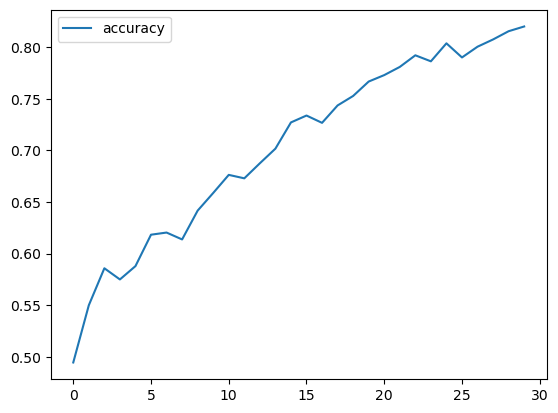

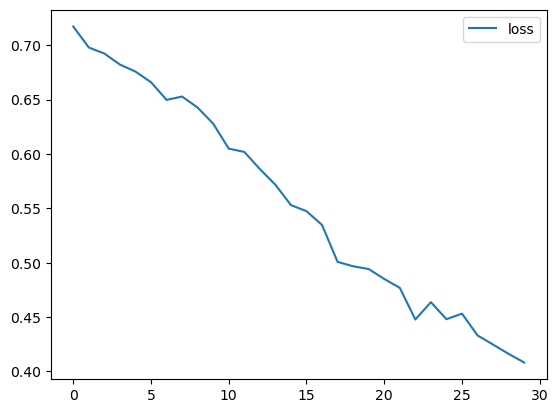

In [27]:
plt.plot(history.history['acc'], label='accuracy')
plt.legend()
plt.show()

plt.plot(history.history['loss'], label='loss')
plt.legend()

In [28]:
model.evaluate(valid_gen)
model.save("Gender_classification.keras")

42/42 [==============================] - 2s 34ms/step - loss: 0.3335 - acc: 0.8600


In [29]:
# Load model
if os.path.isfile('Gender_classification.keras'):
    model = tf.keras.models.load_model('Gender_classification.keras')
else:
    print("Gender classification model could not be loaded")

In [30]:
class_names = ["Female", "Male"]
false_classified_images = []

# Predict to test data and save false classified data
for i, test_g in enumerate(test_gen):
    # print(f"\n{i}")
    if i  == 100:
        break
    x_batch, y_batch = test_g
    predictions = model.predict(x_batch)
    predicted_labels = (predictions > 0.5).astype(int).flatten()

    for x, y, prediction in zip(x_batch, y_batch, predicted_labels):
        true_label = class_names[int(y)]
        predicted_label = class_names[prediction]

        if true_label != predicted_label:
            false_classified_images.append((x, true_label, predicted_label))

# Sort false classified data after "false" (False negative) and "true" (false positive)
false_classified_images = sorted(false_classified_images, key=lambda xy: xy[1])  # Sort alphabetically
false_classified_images

1/1 [==============================] - 0s 26ms/step


[(array([[[0.60784316, 0.5176471 , 0.5411765 ],
          [0.6117647 , 0.52156866, 0.5529412 ],
          [0.6117647 , 0.52156866, 0.5529412 ],
          ...,
          [0.8117648 , 0.7254902 , 0.73333335],
          [0.8117648 , 0.7254902 , 0.73333335],
          [0.8117648 , 0.7254902 , 0.73333335]],
  
         [[0.627451  , 0.5372549 , 0.56078434],
          [0.62352943, 0.53333336, 0.5568628 ],
          [0.62352943, 0.53333336, 0.5568628 ],
          ...,
          [0.8117648 , 0.7254902 , 0.73333335],
          [0.8117648 , 0.7254902 , 0.73333335],
          [0.8117648 , 0.7254902 , 0.73333335]],
  
         [[0.62352943, 0.5372549 , 0.54901963],
          [0.62352943, 0.5372549 , 0.54901963],
          [0.62352943, 0.5372549 , 0.54901963],
          ...,
          [0.8117648 , 0.7254902 , 0.73333335],
          [0.8117648 , 0.7254902 , 0.73333335],
          [0.8117648 , 0.7254902 , 0.73333335]],
  
         ...,
  
         [[0.8078432 , 0.54509807, 0.36862746],
          [0.7

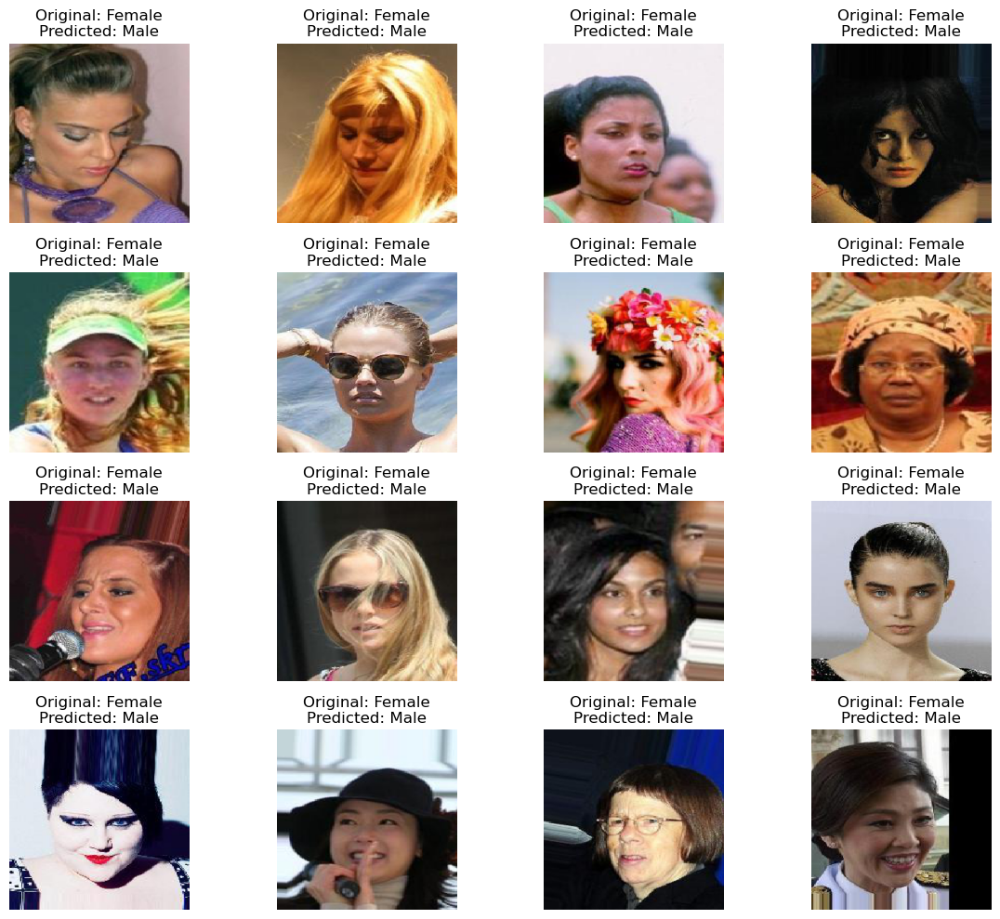

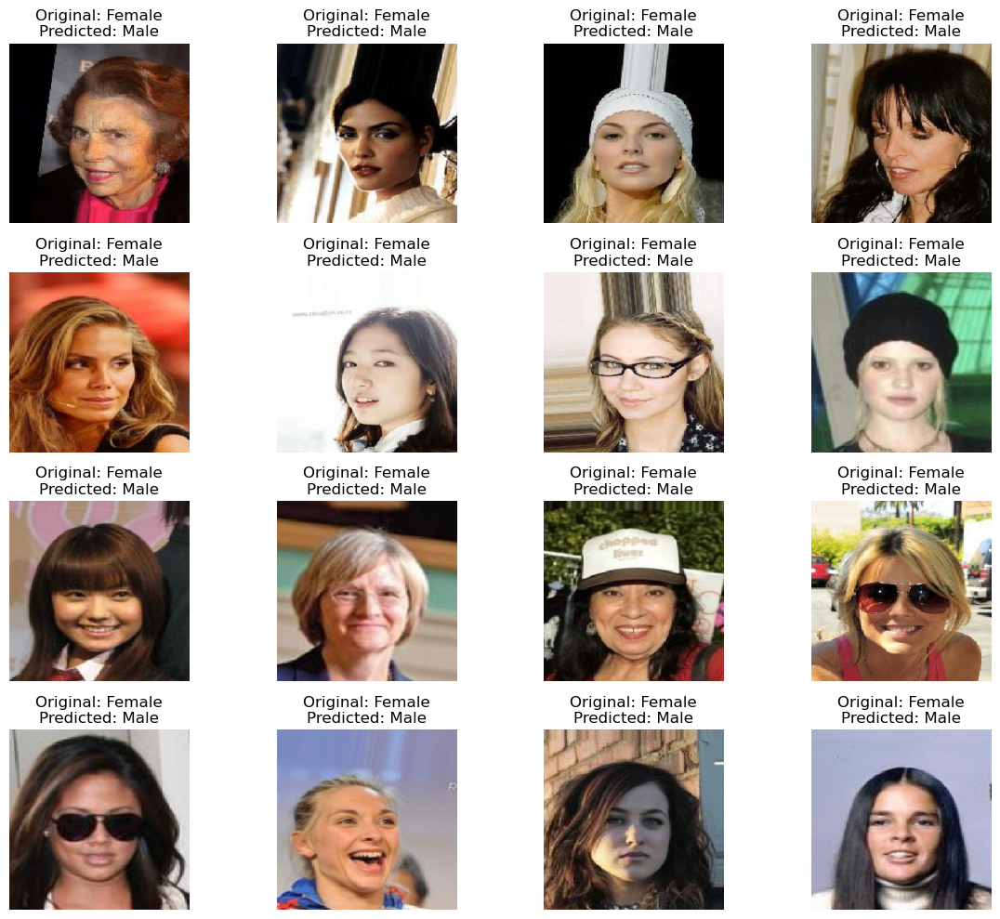

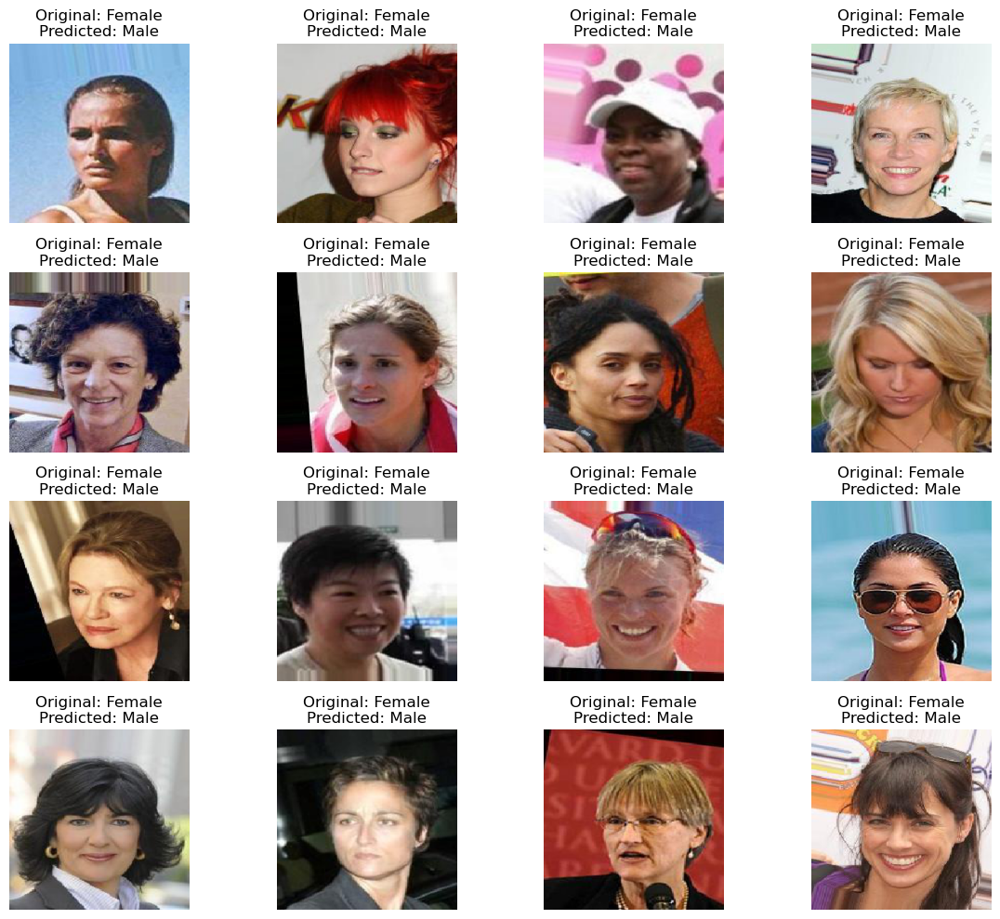

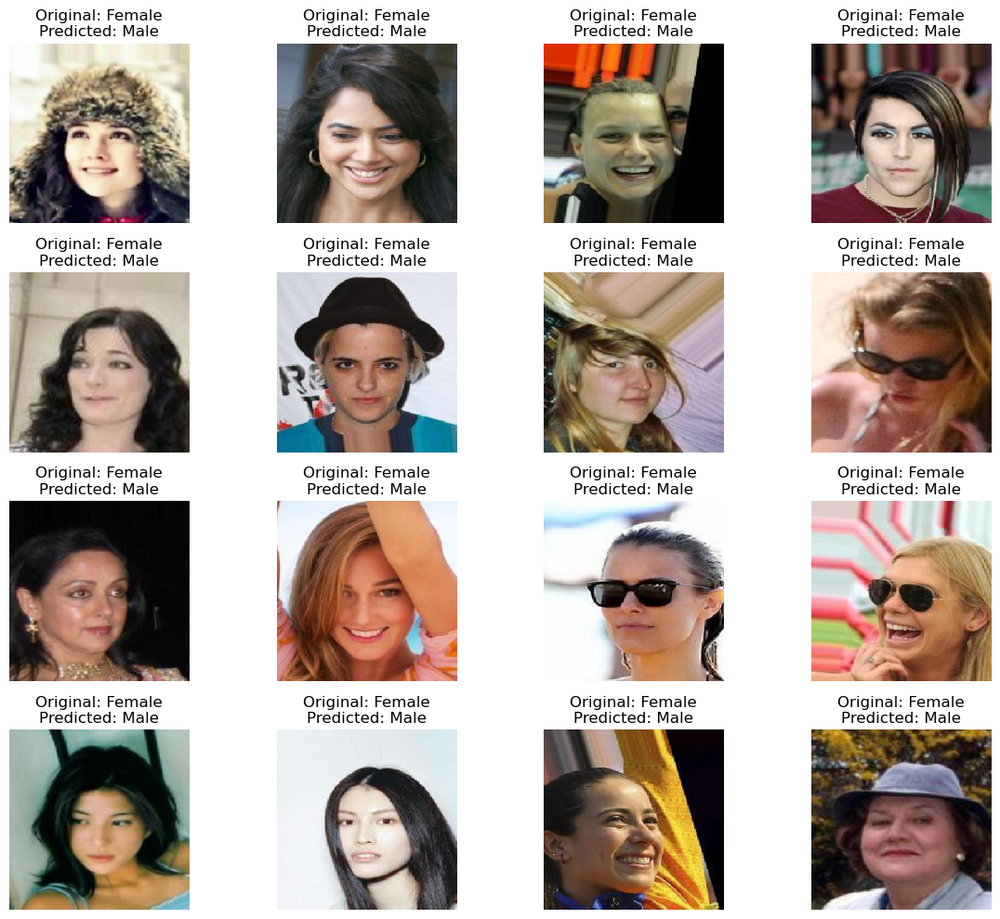

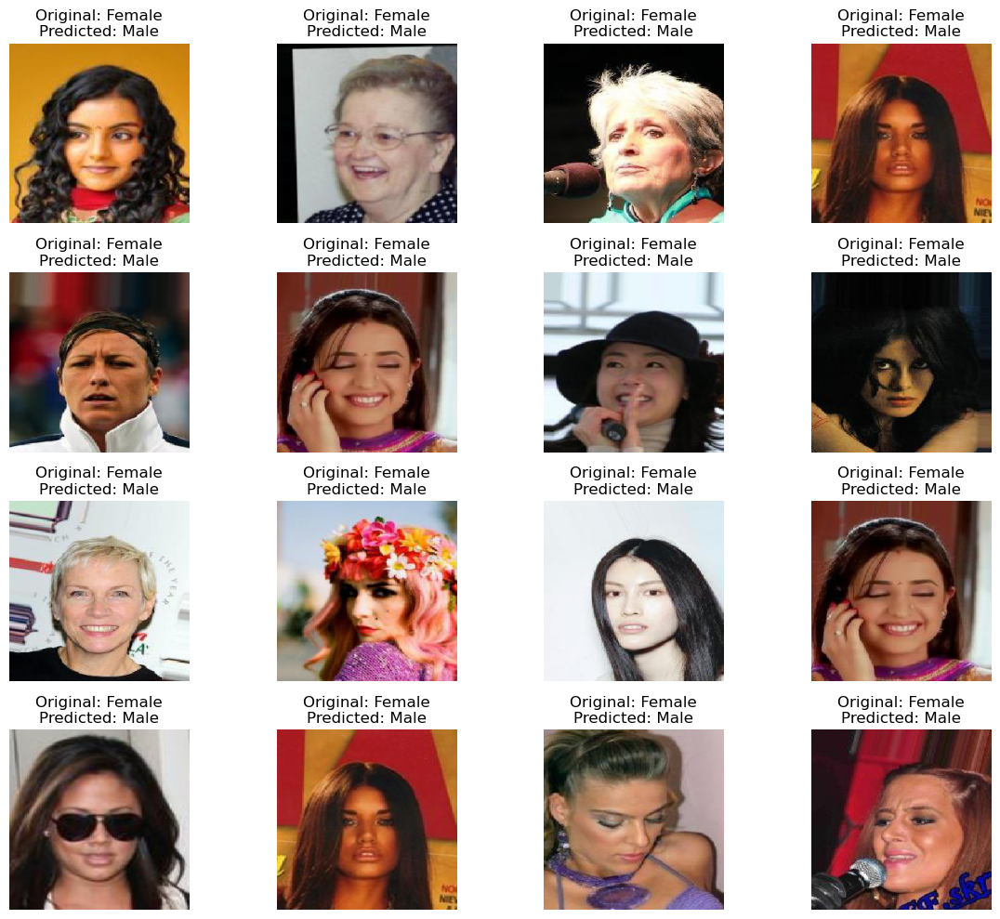

...

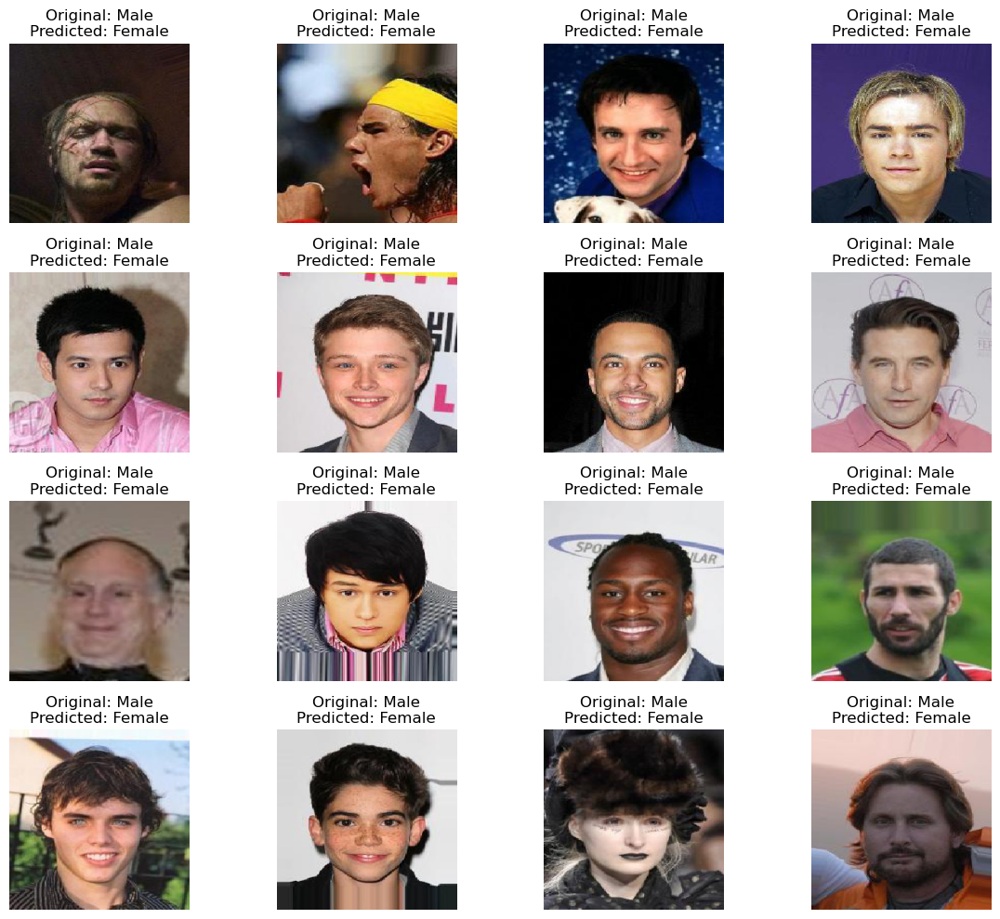

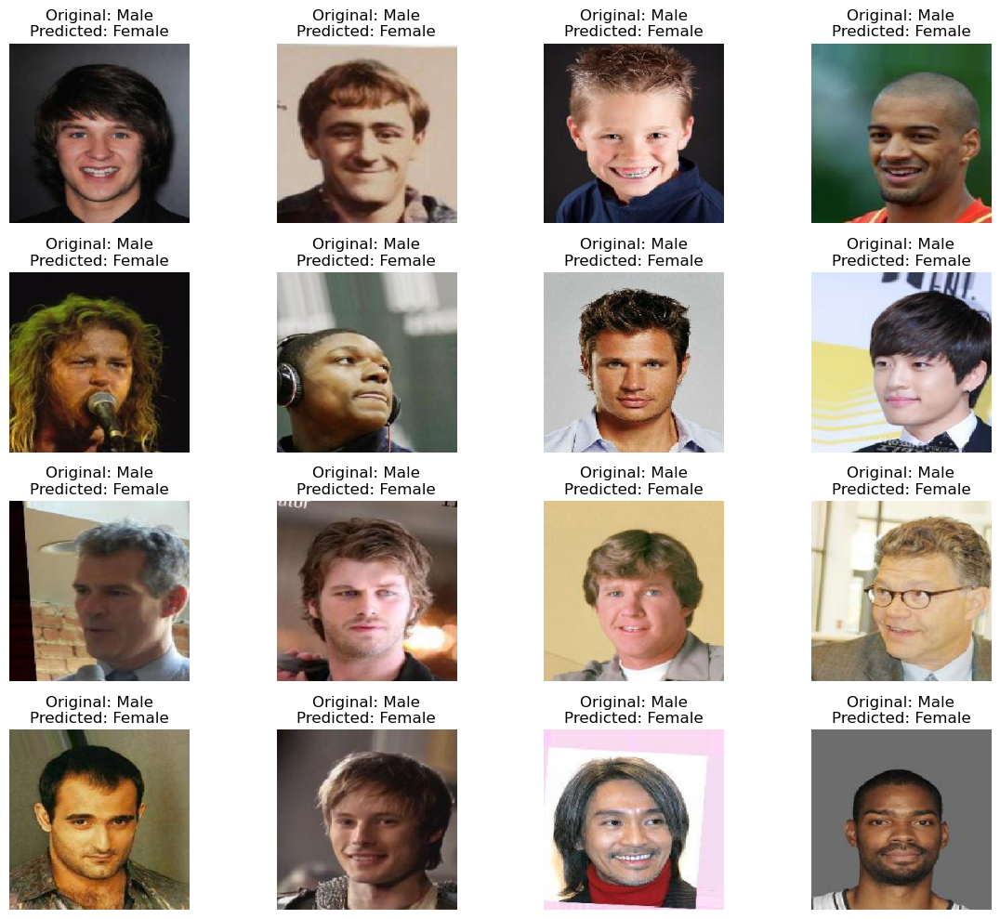

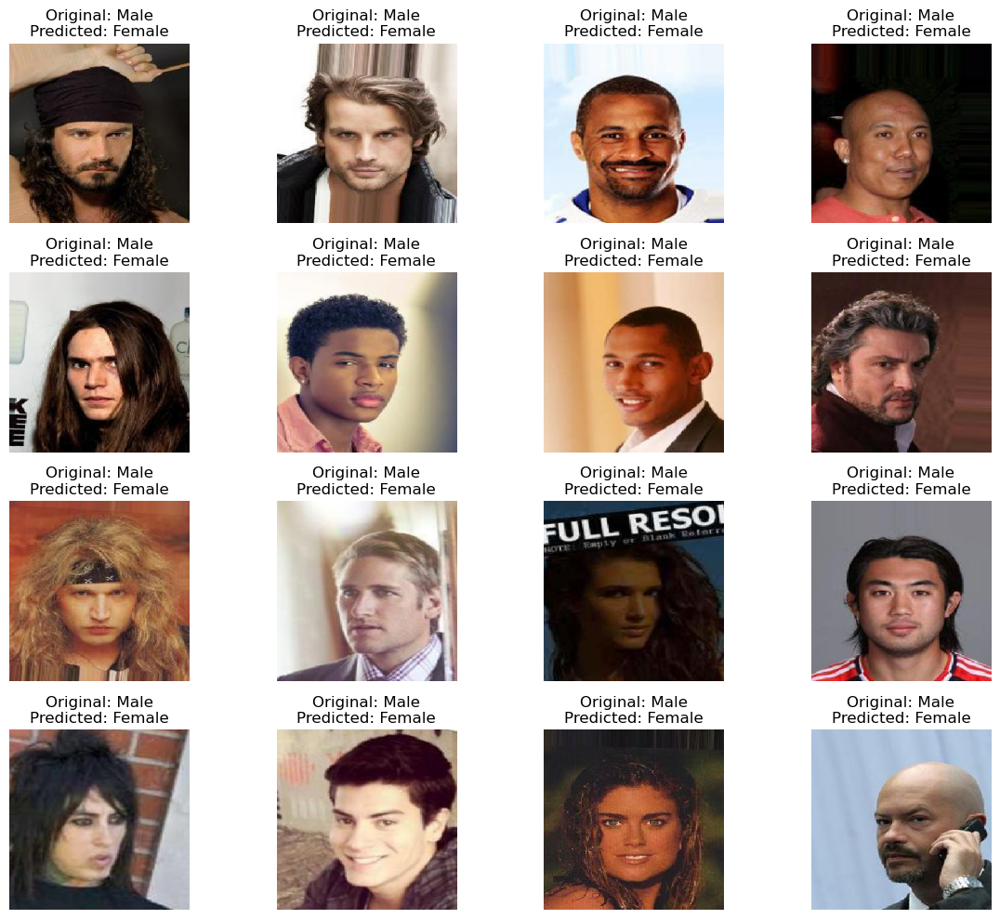

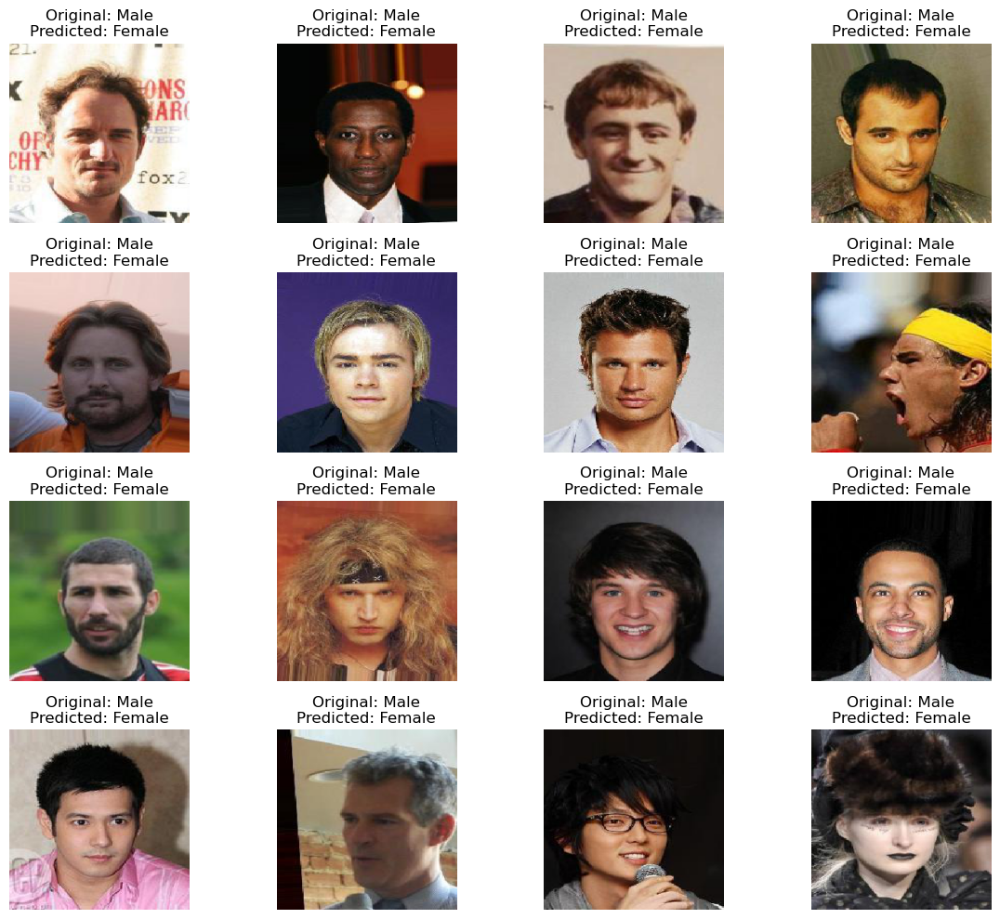

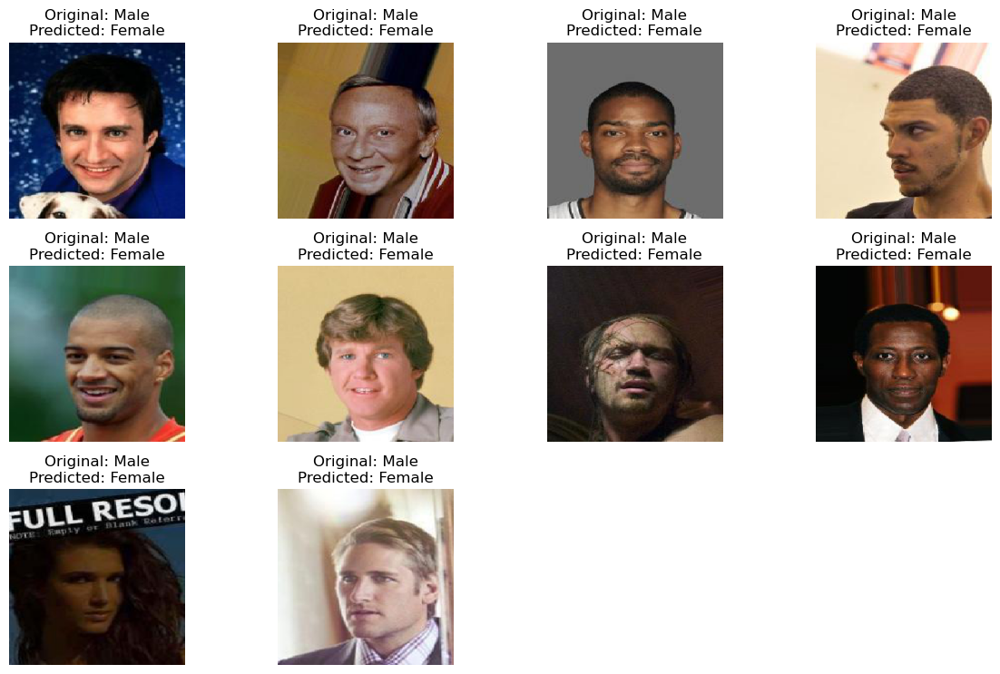

In [47]:
# Plot false classified data
for i in range(0, len(false_classified_images), num_images):
    # Plot num_images images
    fig, axes = plt.subplots(4, 4, figsize=(12, 10))

    for j in range(i, min(i + num_images, len(false_classified_images))):
        x_batch, true_label, predicted_label = false_classified_images[j]
        ax = axes[(j % num_images) // 4, j % 4]
        ax.imshow(x_batch)
        ax.set_title(f"Original: {true_label}\nPredicted: {predicted_label}")
        ax.axis('off')

    if len(false_classified_images) < i + num_images:
        for j in range(len(false_classified_images), i + num_images):
            fig.delaxes(axes[(j % num_images) // 4][j % 4])

    # Show plot
    plt.tight_layout()
    plt.show()

In [48]:
def edit_image(image_path: str) -> np.array: 
    img = load_img(image_path, target_size=(250, 250))

    img_array = img_to_array(img)
    img_array = img_array / 255.0 

    img_array = np.expand_dims(img_array, axis=0)
    
    return img_array

In [50]:
class_names = ["Female", "Male"]

images = glob.glob('Test_images/*.jpg')

for i, image in enumerate(images):
    img_array = edit_image(image)
    
    prediction = model.predict(img_array)
    predicted_labels = (prediction > 0.5).astype(int).flatten()
    predicted_label = class_names[predicted_labels[0]]

    plt.imshow(load_img(image))
    plt.title(f"Prediction: {predicted_label} {prediction}")
    plt.axis("off")
    plt.show()
